## Imports (common)

In [1]:
import os
import numpy as np
import gc
import h5py
import scipy.io
import scipy.signal as sgl
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score
from sklearn.feature_selection import VarianceThreshold
from sklearn.preprocessing import StandardScaler, label_binarize
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_auc_score, balanced_accuracy_score # Added balanced_accuracy_score
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, ExtraTreesClassifier
from sklearn.decomposition import PCA
from sklearn.model_selection import GridSearchCV, cross_val_score
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, Flatten, Dense, Dropout, BatchNormalization, LSTM, GRU
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.utils import to_categorical
from scipy.stats import skew, kurtosis
from scipy.signal import welch
import neurokit2 as nk
# from imblearn.over_sampling import SMOTE # Not using SMOTE currently

## Data Loading & Preprocessing

In [2]:
# --- Constants for Windowing ---
FS = 128
WINDOW_SEC = 2 # Try 2 seconds first
STEP_SEC = 1   # Correspondingly smaller step (e.g., 50% overlap)
WINDOW_SAMPLES = int(WINDOW_SEC * FS) # Will be 256
STEP_SAMPLES = int(STEP_SEC * FS)     # Will be 128


# --- Data Loading Function ---
def load_patient_preprocessed_data(patient_number):
    # Keep this function as is
    base_dir = r"C:\Users\ferri\Downloads\PoliTO\Tesi\DSs\Emotion-Stress\AMIGOS"
    file_path = os.path.join(
        base_dir, "Data preprocessed",
        f"Data_Preprocessed_P{patient_number:02d}",
        f"Data_Preprocessed_P{patient_number:02d}.mat"
    )
    data = scipy.io.loadmat(file_path)
    return data

# --- Preprocessing functions for pipeline ---
def process_trial_signal(signal, target_length=None, fs=512):
    """
    Convert a trial's raw signal into a 2D array [channels, time].
    Applies transpose fix, downsampling, filtering, baseline removal.
    """
    # Convert to float32.
    signal = np.array(signal, dtype=np.float32)

    # --- ADD TRANSPOSE STEP ---
    # Check if dimensions look like (samples, channels) and transpose if needed
    if signal.ndim == 2 and signal.shape[0] > signal.shape[1]:
         # Heuristic: If rows > columns, assume it's (samples, channels)
         print(f"    Transposing input signal from {signal.shape} to {signal.T.shape}") # Add print
         signal = signal.T # Transpose to (channels, samples)
    # --- END TRANSPOSE STEP ---

    # Check if signal is empty AFTER potential transpose
    if signal.size == 0:
        return np.empty((0,0), dtype=np.float32)

    # If the signal is 1D, reshape to (1, length).
    # This should happen AFTER transpose if original was (L, 1)
    if signal.ndim == 1:
        signal = signal[None, :] # Now shape (1, L)

    # Downsampling parameters.
    N = 4
    lowcut, highcut = 1.0, 45.0
    desired_fs = 128 # This is the FS used for feature extraction later
    down_factor = fs // desired_fs

    # 1) Downsample each channel. (Now iterates correctly over channels)
    downsampled = []
    for ch_data in signal: # ch_data should now be one channel's time series
        if ch_data.size == 0: continue
        ch_data_down = ch_data[::down_factor]
        downsampled.append(ch_data_down)

    # If no channels had data, return an empty array.
    if not downsampled:
        return np.empty((0,0), dtype=np.float32)

    # Stack downsampled channels. Pad if necessary (though simple slicing should yield same length)
    try:
        max_len_down = max(len(ch) for ch in downsampled)
        padded_downsampled = []
        for ch in downsampled:
             pad_width = max_len_down - len(ch)
             if pad_width > 0:
                  padded_ch = np.pad(ch, (0, pad_width), mode='edge')
                  padded_downsampled.append(padded_ch)
             else:
                  padded_downsampled.append(ch)
        signal = np.vstack([ch[None, :] for ch in padded_downsampled])
    except ValueError as e:
         print(f"Error during vstack after downsampling: {e}. Lengths: {[len(ch) for ch in downsampled]}")
         return np.empty((0,0), dtype=np.float32) # Return empty on error

    # 2) Bandpass filter design.
    nyquist = 0.5 * desired_fs
    b, a = sgl.butter(N=4, Wn=[lowcut/nyquist, highcut/nyquist], btype='band')
    min_len_filt = 3 * (max(len(a), len(b)) - 1) # Renamed variable

    # Filter each channel; if too short, skip filtering.
    filtered = []
    for ch_data in signal:
        if len(ch_data) < min_len_filt:
            ch_data_filt = ch_data  # Fallback: leave unfiltered.
        else:
            try:
                 ch_data_filt = sgl.filtfilt(b, a, ch_data)
            except ValueError as e: # Add specific error handling for filtfilt
                 print(f"    filtfilt error: {e} on data length {len(ch_data)}. Skipping filter.")
                 ch_data_filt = ch_data # Fallback if filtfilt fails
        filtered.append(ch_data_filt)
    signal = np.vstack([ch[None, :] for ch in filtered])

    # 3) Baseline removal (subtract mean from each channel).
    baseline_removed = []
    for ch_data in signal:
        mean_val = np.mean(ch_data) if ch_data.size > 0 else 0
        ch_data_bs = ch_data - mean_val
        baseline_removed.append(ch_data_bs)
    signal = np.vstack([ch[None, :] for ch in baseline_removed])

    # 4) Padding/Truncation - Keep disabled if target_length is None
    if target_length is not None:
        processed = []
        for ch_data in signal:
            ch_len = len(ch_data)
            if ch_len == 0:
                proc = np.zeros(target_length, dtype=np.float32)
            elif ch_len < target_length:
                pad_width = target_length - ch_len
                proc = np.pad(ch_data, (0, pad_width), mode='edge')
            else:
                proc = ch_data[:target_length]
            processed.append(proc.astype(np.float32))
        signal = np.vstack([p[None, :] for p in processed])

    return signal.astype(np.float32)


def split_into_modalities(signal_window):
    # Keep this function as is, it works on a window [channels, time]
    # If the signal is 1D, assume it represents a single modality (e.g., ECG).
    if signal_window.ndim == 1:
        # Reshape if 1D (e.g., single channel passed)
        signal_window = signal_window[None, :]
        if signal_window.shape[0] == 1: # Assume it's ECG if only one channel
            return {"ecg": signal_window.flatten()}
        else: # Should not happen if input is always [channels, time]
             return {}

    elif signal_window.ndim == 2:
        # If multi-channel, split into ECG, GSR, and EEG as desired.
        # Adjust indices based on your actual channel order in 'joined_data'
        # Assuming: 0=ECG, 1=GSR, 2=EEG (as per your original code)
        modalities = {}
        if signal_window.shape[0] > 0:
            modalities["ecg"] = signal_window[0, :]
        if signal_window.shape[0] > 1:
            modalities["gsr"] = signal_window[1, :]
        if signal_window.shape[0] > 2:
             # Assuming EEG is just the 3rd channel for simplicity here
             # If multiple EEG channels, you'd handle them differently in extract_features
            modalities["eeg"] = signal_window[2, :]
        return modalities
    else:
        # Handle unexpected dimensions
        print(f"Warning: Unexpected signal dimension {signal_window.ndim}")
        return {}


def discretize_label(label):
    # Keep this function as is
    flat_label = np.array(label).flatten()  # Ensure label is 1D.
    if flat_label.size == 2:
        valence, arousal = flat_label
    elif flat_label.size >= 3:
        valence, arousal = flat_label[1], flat_label[2]
    else:
        return "Unknown"

    if valence < 0 and arousal < 0:
        return "Low valence, Low arousal"
    elif valence < 0 and arousal >= 0:
        return "Low valence, High arousal"
    elif valence >= 0 and arousal < 0:
        return "High valence, Low arousal"
    else:
        return "High valence, High arousal"

# --- Feature Extraction Functions ---
def extract_features(signals_dict, fs=FS): # Use FS=128 defined above
    # Keep this function as is, it extracts features from a dictionary of signals (now windowed signals)
    """
    Extract features for multiple signals (ECG, GSR, EEG) from a dictionary.
    If advanced processing (e.g., HRV from ECG) fails, falls back to basic statistics.
    **Consider adding more advanced features here later.**
    """
    feat_list = []
    # --- ECG Features (Consider adding more HRV: nk.hrv_frequency, nk.hrv_nonlinear) ---
    if 'ecg' in signals_dict:
        ecg_signal = np.array(signals_dict['ecg']).flatten()
        # Check length against minimum needed by neurokit processing steps
        min_len_nk = 30 # Arbitrary minimum, adjust based on nk requirements for short signals
        if len(ecg_signal) < min_len_nk:
             # Fallback for very short windows
            basic_stats = [np.mean(ecg_signal), np.std(ecg_signal), np.min(ecg_signal), np.max(ecg_signal), np.median(ecg_signal)]
            ecg_feats = basic_stats + [0.0] * (10 - len(basic_stats)) # Pad to expected length
        else:
            try:
                ecg_cleaned = nk.ecg_clean(ecg_signal, sampling_rate=fs)
                _, rpeaks = nk.ecg_peaks(ecg_cleaned, sampling_rate=fs, correct_artifacts=True) # Added correct_artifacts
                # Check if enough R-peaks were detected for HRV analysis
                if len(rpeaks.get("ECG_R_Peaks", [])) < 3: # Need at least a few peaks for HRV
                    raise ValueError("Not enough R-peaks detected for HRV.")
                hrv = nk.hrv(rpeaks, sampling_rate=fs, show=False)
                # Select a consistent set of HRV features (adjust as needed)
                feature_names = [
                    "RMSSD", "SDNN", "pNN50", "pNN20",
                    "LFHF", # Use LFHF instead of LF/HF if available
                    "HF", "LF", "VLF", "SDSD", "IQRNN" # Replaced HRV_TI with IQRNN
                 ]
                ecg_feats = []
                # Check HRV columns, handle potential missing columns or NaNs
                hrv_cols = hrv.columns
                for name in feature_names:
                     # Handle different naming conventions (e.g., LF/HF vs LFHF)
                    actual_name = name
                    if name == "LFHF" and "LF/HF" in hrv_cols:
                        actual_name = "LF/HF"
                    elif name == "LF/HF" and "LFHF" in hrv_cols:
                         actual_name = "LFHF"

                    if actual_name in hrv_cols and not np.isnan(hrv[actual_name].values[0]):
                         ecg_feats.append(hrv[actual_name].values[0])
                    else:
                         ecg_feats.append(0.0) # Use 0.0 for missing/NaN features

                 # Ensure we always have 10 features
                if len(ecg_feats) < 10:
                    ecg_feats.extend([0.0] * (10 - len(ecg_feats)))
                elif len(ecg_feats) > 10:
                     ecg_feats = ecg_feats[:10] # Truncate if more than 10 somehow

            except Exception as e:
                # Fallback: Compute basic statistics if advanced features fail.
                # print(f"Warning: ECG feature extraction failed for a window: {e}") # Optional warning
                basic_stats = [
                     np.mean(ecg_signal) if len(ecg_signal) > 0 else 0.0,
                     np.std(ecg_signal) if len(ecg_signal) > 1 else 0.0,
                     np.min(ecg_signal) if len(ecg_signal) > 0 else 0.0,
                     np.max(ecg_signal) if len(ecg_signal) > 0 else 0.0,
                     np.median(ecg_signal) if len(ecg_signal) > 0 else 0.0
                 ]
                # Pad to reach length 10.
                ecg_feats = basic_stats + [0.0] * (10 - len(basic_stats))
        feat_list.append(np.array(ecg_feats))

    # --- GSR Features (Consider nk.eda_phasic features: SCR_Peaks_Amplitude_Mean, etc.) ---
    if 'gsr' in signals_dict:
        gsr_signal = np.array(signals_dict['gsr']).flatten()
        if len(gsr_signal) > 2: # Need at least 3 points for stats like skew/kurtosis
            try:
                # Use nk.eda_process for more robust feature extraction
                eda_signals, info = nk.eda_process(gsr_signal, sampling_rate=fs)
                num_scr_peaks = len(info["SCR_Peaks"])
                mean_scr_amp = np.mean(eda_signals["SCR_Amplitude"]) if len(info["SCR_Peaks"]) > 0 else 0.0
                mean_scl = np.mean(eda_signals["EDA_Tonic"])
                std_scl = np.std(eda_signals["EDA_Tonic"])

                # Replace basic stats with these more informative ones + some basic stats
                gsr_feats = [
                     mean_scl, # Mean Tonic component
                     std_scl, # Std Dev Tonic
                     num_scr_peaks, # Number of SCR peaks in window
                     mean_scr_amp, # Mean SCR Amplitude
                     kurtosis(gsr_signal),
                     skew(gsr_signal),
                     np.std(gsr_signal) # Keep overall std dev
                 ]
            except Exception as e:
                 # Fallback to basic stats if eda_process fails
                 # print(f"Warning: GSR feature extraction failed: {e}") # Optional
                 num_scr_peaks = 0.0 # Default if failed
                 gsr_feats = [
                     np.mean(gsr_signal), np.std(gsr_signal),
                     np.min(gsr_signal), np.max(gsr_signal),
                     kurtosis(gsr_signal) if len(gsr_signal)>3 else 0.0,
                     skew(gsr_signal) if len(gsr_signal)>3 else 0.0,
                     num_scr_peaks
                 ]
        else:
             gsr_feats = [0.0] * 7 # Default for too short signal
        feat_list.append(np.array(gsr_feats))

    # --- EEG Features (Consider specific band powers: Alpha, Beta, Gamma, Theta, Delta & Ratios) ---
    if 'eeg' in signals_dict:
        eeg_data = np.array(signals_dict['eeg'])
        if eeg_data.ndim == 1:
            eeg_data = eeg_data[None, :]  # Ensure 2D shape [channels, time]

        all_channels_feats = []
        for ch in range(eeg_data.shape[0]):
            channel_signal = eeg_data[ch, :]
            # Need enough data points for reliable PSD calculation with Welch
            min_len_welch = 256 # Or adjust nperseg based on window size
            if len(channel_signal) < min_len_welch:
                 ch_feats = [0.0] * 8 # Default value for all EEG features if too short
            else:
                try:
                    # Hjorth parameters
                    activity = np.var(channel_signal)
                    diff_signal = np.diff(channel_signal)
                    mobility = np.sqrt(np.var(diff_signal) / (activity + 1e-8))
                    diff_diff_signal = np.diff(diff_signal)
                    complexity = np.sqrt(np.var(diff_diff_signal) / (np.var(diff_signal) + 1e-8)) / (mobility + 1e-8)

                    # Band power using Welch
                    # Adjust nperseg based on window length, ensure it's not longer than signal
                    nperseg = min(min_len_welch, len(channel_signal))
                    freqs, psd = welch(channel_signal, fs=fs, nperseg=nperseg)

                    def bandpower(f, pxx, fmin, fmax):
                        idx = np.logical_and(f >= fmin, f <= fmax)
                        if not np.any(idx): return 0.0 # Handle case where band is outside freq range
                         # Use trapezoid integration
                        return np.trapz(pxx[idx], x=f[idx])

                    # Define frequency bands
                    delta = bandpower(freqs, psd, 1, 4)
                    theta = bandpower(freqs, psd, 4, 8)
                    alpha = bandpower(freqs, psd, 8, 13) # Adjusted alpha range
                    beta  = bandpower(freqs, psd, 13, 30) # Adjusted beta range
                    gamma = bandpower(freqs, psd, 30, 45) # Limited gamma to match filtering

                    # Combine Hjorth and band powers
                    ch_feats = [activity, mobility, complexity, delta, theta, alpha, beta, gamma]

                except Exception as e:
                    # print(f"Warning: EEG feature extraction failed for channel {ch}: {e}") # Optional
                    ch_feats = [0.0] * 8 # Default if any error occurs

            all_channels_feats.append(ch_feats)

        # Average features across channels (if multiple EEG channels were processed)
        # If only one channel, this just returns that channel's features
        eeg_feats = np.mean(all_channels_feats, axis=0)
        feat_list.append(eeg_feats)

    # ---------- Combine all features ----------
    if len(feat_list) == 0:
        # Return array of zeros with expected total feature dimension
        # (10 ECG + 7 GSR + 8 EEG = 25 features)
        return np.zeros(25)
    # Concatenate features from all modalities processed
    combined_features = np.concatenate(feat_list)

    # Ensure consistent length (e.g., if one modality was missing)
    expected_len = 25 # Update this if you change the number of features per modality
    if len(combined_features) < expected_len:
        combined_features = np.pad(combined_features, (0, expected_len - len(combined_features)), 'constant')
    elif len(combined_features) > expected_len:
        combined_features = combined_features[:expected_len] # Should not happen with careful implementation

    return combined_features


# --- NEW FUNCTION: Build Windowed Dataset ---
def build_windowed_dataset(joined_data, labels_array):
    X_list = []
    y_list = []
    n_trials = joined_data.shape[1]

    print(f"Processing {n_trials} trials for windowing...")

    for i in range(n_trials):
        # 1. Get preprocessed signal for the *entire* trial
        #    Set target_length=None as windowing handles length implicitly
        trial_signal_processed = process_trial_signal(joined_data[0, i], target_length=None, fs=512)

        # --- ADD DEBUG PRINTS ---
        # print(f"  Trial {i}: Processed signal shape = {trial_signal_processed.shape}")
        # if trial_signal_processed.shape[1] > 0: # Avoid errors if shape is (n, 0)
        #     print(f"            Signal length = {trial_signal_processed.shape[1]} samples. Required >= {WINDOW_SAMPLES}")
        # --- END DEBUG PRINTS ---

        if trial_signal_processed.size == 0 or trial_signal_processed.shape[1] < WINDOW_SAMPLES:
            print(f"  Trial {i}: Skipping - Signal empty or too short.") # Simplified message
            continue # Skip trial if too short for even one window

        # 2. Get the corresponding label for this trial
        lbl = np.array(labels_array[0, i]).squeeze()
        if lbl.size < 3:
            # print(f"Warning: Trial {i} does not have enough label data. Skipping trial.")
            continue
        selected_label = lbl[1:3]  # use only valence and arousal
        discrete_label = discretize_label(selected_label)
        if discrete_label == "Unknown":
             # print(f"Warning: Trial {i} has unknown label. Skipping trial.")
             continue

        # 3. Iterate through windows of the trial signal
        num_samples_trial = trial_signal_processed.shape[1]
        for start in range(0, num_samples_trial - WINDOW_SAMPLES + 1, STEP_SAMPLES):
            end = start + WINDOW_SAMPLES
            signal_window = trial_signal_processed[:, start:end] # Shape [channels, WINDOW_SAMPLES]

            # 4. Extract features for this window
            signals_dict = split_into_modalities(signal_window)
            if not signals_dict: # Check if split failed
                 continue
            window_features = extract_features(signals_dict, fs=FS)

            # 5. Append features and the trial's label
            X_list.append(window_features)
            y_list.append(discrete_label)

    if len(X_list) == 0:
        print("Warning: No windows generated from the data.")
        return None, None

    X_array = np.vstack(X_list)
    y_array = np.array(y_list)
    print(f"Generated {X_array.shape[0]} windows from {n_trials} trials.")
    return X_array, y_array


# --- NEW FUNCTION: Load all patient data using windowing ---
def load_all_patients_windowed_data(num_patients=40):
    X_list_all = []
    y_list_all = []
    for patient in range(1, num_patients + 1):
        print(f"\nLoading and windowing patient {patient}...")
        try:
            data = load_patient_preprocessed_data(patient)
            joined_data = data['joined_data']
            labels_array = data['labels_ext_annotation']

            # Use the new windowed function
            X_patient_windows, y_patient_windows = build_windowed_dataset(joined_data, labels_array)

            if X_patient_windows is not None and y_patient_windows is not None:
                X_list_all.append(X_patient_windows)
                y_list_all.append(y_patient_windows)
            else:
                 print(f"No windows generated for patient {patient}.")
            # Clean up memory
            del data, joined_data, labels_array, X_patient_windows, y_patient_windows
            gc.collect()
        except Exception as e:
            print(f"Error processing patient {patient}: {e}")


    if not X_list_all: # Check if the list is empty
        raise ValueError("No windowed data loaded for any patient.")

    X_all_windows = np.vstack(X_list_all)
    y_all_windows = np.concatenate(y_list_all)

    print(f"\nTotal windows loaded from all patients: {X_all_windows.shape[0]}")
    return X_all_windows, y_all_windows

# --- Remove old loading functions not needed now ---
# def build_patient_data(joined_data, label_array): ... # Removed
# def load_all_patients_data(num_patients=40): ... # Removed
# def load_all_patients_raw_signal(num_patients=40, target_length=None): ... # Removed
# def pad_trials(trials, pad_mode='constant', constant_values=0): ... # Removed (padding within windowing/feature extraction if needed)


## Define/Ensure Prerequisite Variables for Exploration, Balancing, and Selection

In [3]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from tensorflow.keras.utils import to_categorical # Keep if you need categorical later, not strictly needed for these vars
import warnings

# --- Check if base data exists ---
if 'X_windows' not in locals() or 'y_windows_desc' not in locals():
    warnings.warn("Base data 'X_windows' or 'y_windows_desc' not found in locals. Trying to reload...")
    # Attempt to reload (assuming the loading function is available)
    try:
        print("Attempting to reload windowed data...")
        # Set num_patients appropriately or load from a saved file if preferred
        X_windows, y_windows_desc = load_all_patients_windowed_data(num_patients=40) # Or load from file
        if X_windows is None or y_windows_desc is None:
             raise ValueError("Failed to reload data.")
        print("Reload successful.")
    except Exception as e:
        raise RuntimeError(f"Could not find or reload base windowed data. Please run the initial data loading cells first. Error: {e}")

# --- 1. Recreate Label Mapping and Integer Labels ---
print("Defining labels and mapping...")
unique_labels_w = np.unique(y_windows_desc)
# Define label_to_int_w (this overwrites previous definition if run before, which is intended here)
label_to_int_w = {label: idx for idx, label in enumerate(unique_labels_w)}
y_int_windows = np.array([label_to_int_w[label] for label in y_windows_desc])
print(f"Label mapping created: {label_to_int_w}")
print(f"Integer window labels shape: {y_int_windows.shape}")
print(f"Class distribution in full windowed data: {np.bincount(y_int_windows)}")

# --- 2. Re-split Data ---
# Ensure consistent split with the original code
print("Splitting data into train/test sets...")
X_train_w, X_test_w, y_train_labels_w, y_test_labels_w, y_int_train_w, y_int_test_w = train_test_split(
    X_windows, y_windows_desc, y_int_windows,
    test_size=0.2, random_state=42, stratify=y_int_windows # Use same random_state and stratify
)
print(f"Train window data shape: {X_train_w.shape}")
print(f"Test window data shape: {X_test_w.shape}")
print(f"Train integer labels shape: {y_int_train_w.shape}")
print(f"Test integer labels shape: {y_int_test_w.shape}")
print(f"Class distribution in train windows: {np.bincount(y_int_train_w)}")
print(f"Class distribution in test windows: {np.bincount(y_int_test_w)}")


# --- 3. Re-apply Imputation ---
print("Applying Imputation (mean)...")
if X_train_w.size > 0:
    # Fit imputer ONLY on the training data partition from this split
    imputer_w_local = SimpleImputer(strategy='mean').fit(X_train_w)
    X_train_w_imputed = imputer_w_local.transform(X_train_w)
    X_test_w_imputed = imputer_w_local.transform(X_test_w)
    print("Imputation complete.")

    # Check for NaNs/Infs after imputation (important sanity check)
    if np.any(np.isnan(X_train_w_imputed)) or np.any(np.isinf(X_train_w_imputed)):
        print("Warning: NaNs or Infs found in training data AFTER imputation! Replacing with 0.")
        X_train_w_imputed = np.nan_to_num(X_train_w_imputed, nan=0.0, posinf=0.0, neginf=0.0)
    if np.any(np.isnan(X_test_w_imputed)) or np.any(np.isinf(X_test_w_imputed)):
        print("Warning: NaNs or Infs found in test data AFTER imputation! Replacing with 0.")
        X_test_w_imputed = np.nan_to_num(X_test_w_imputed, nan=0.0, posinf=0.0, neginf=0.0)
else:
     raise ValueError("Training data partition (X_train_w) is empty after split. Cannot proceed.")

# --- 4. Re-apply Scaling ---
print("Applying StandardScaler...")
# Fit scaler ONLY on the imputed training data partition
scaler_w_local = StandardScaler().fit(X_train_w_imputed)

# Define the final variables required by subsequent cells
X_train_final = scaler_w_local.transform(X_train_w_imputed)
X_test_final = scaler_w_local.transform(X_test_w_imputed)
y_train_final = y_int_train_w  # Use the integer labels from the split
y_test_final = y_int_test_w   # Use the integer labels from the split
print("Scaling complete.")

# --- Final Check ---
print("\n--- Prerequisite variables defined ---")
print(f"X_train_final shape: {X_train_final.shape}")
print(f"X_test_final shape: {X_test_final.shape}")
print(f"y_train_final shape: {y_train_final.shape}")
print(f"y_test_final shape: {y_test_final.shape}")
print(f"label_to_int_w defined: {'label_to_int_w' in locals() and isinstance(label_to_int_w, dict)}")
print("--------------------------------------")

# Optional: Clean up intermediate variables from this cell if desired
# del X_train_w, X_test_w, y_train_labels_w, y_test_labels_w, y_int_train_w, y_int_test_w
# del X_train_w_imputed, X_test_w_imputed, imputer_w_local, scaler_w_local
# gc.collect() # If you imported gc

C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\4237083768.py:10: UserWarning: Base data 'X_windows' or 'y_windows_desc' not found in locals. Trying to reload...
  warnings.warn("Base data 'X_windows' or 'y_windows_desc' not found in locals. Trying to reload...")


Attempting to reload windowed data...

Loading and windowing patient 1...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (10575, 17) to (17, 10575)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(r

Generated 1539 windows from 20 trials.

Loading and windowing patient 2...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (7229, 17) to (17, 7229)
    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(l

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

Generated 1539 windows from 20 trials.

Loading and windowing patient 3...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration func

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integratio

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(p

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

Generated 1539 windows from 20 trials.

Loading and windowing patient 4...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (7229, 17) to (17, 7229)
    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (10575, 17) to (17, 10575)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integratio

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(p

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(p

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration func

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, o

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var

Generated 1539 windows from 20 trials.

Loading and windowing patient 5...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (10575, 17) to (17, 10575)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integratio

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integratio

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(lengths) >= 4) / len(lengths)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.

    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

Generated 1539 windows from 20 trials.

Loading and windowing patient 6...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration func

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:340: RuntimeWarning: divide by zero encountered in scalar divide
  out["SD1SD2"] = sd1 / sd2
C:\Us

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integratio

Generated 1539 windows from 20 trials.

Loading and windowing patient 7...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration func

    Transposing input signal from (7229, 17) to (17, 7229)
    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functio

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

Generated 1539 windows from 20 trials.

Loading and windowing patient 8...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)
    Transposing input signal from (15610, 17) to (17, 15610)
    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)
    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)
    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)
    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)
    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)
    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17)

C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integratio

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _metho

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

Generated 1539 windows from 20 trials.

Loading and windowing patient 10...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (7229, 17) to (17, 7229)
    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _metho

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration func

    Transposing input signal from (8335, 17) to (17, 8335)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] 

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

Generated 1539 windows from 20 trials.

Loading and windowing patient 11...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (10575, 17) to (17, 10575)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(r

    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integratio

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration func

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

Generated 1539 windows from 20 trials.

Loading and windowing patient 12...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_time.py:180: RuntimeWarning: invalid value encountered in scalar divide
  out["SDRMSSD"] = out["SDNN"] / out["RMSSD"]  # Sollers (2007)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integratio

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scal

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _metho

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(r

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (9630, 17) to (17, 9630)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(r

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _metho

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

Generated 1539 windows from 20 trials.

Loading and windowing patient 13...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dt

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encou

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(lengths) >= 4) / len(lengths)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
 

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Lo

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functio

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

Generated 1539 windows from 20 trials.

Loading and windowing patient 14...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encounter

    Transposing input signal from (10575, 17) to (17, 10575)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

Generated 1539 windows from 20 trials.

Loading and windowing patient 15...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(r

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _metho

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

Generated 1539 windows from 20 trials.

Loading and windowing patient 16...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var

    Transposing input signal from (7229, 17) to (17, 7229)
    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(lengths) >= 4) / len(lengths)
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical int

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integratio

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(p

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(lengths) >= 4) / len(lengths)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integrati

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration func

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Lo

Generated 1539 windows from 20 trials.

Loading and windowing patient 17...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(r

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(p

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] 

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] 

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\ecg\ecg_clean.py:106: NeuroKitWarning: There are 256 missing data points in your signal. Filling missing values by using the forward filling method.
  warn(
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\ecg\ecg_clean.py:165: FutureWarning: DataFrame.pad/Series.pad is deprecated. Use DataFrame.ffill/Series.ffill instead
  ecg_signal = pd.DataFrame.pad(pd.Series(ecg_signal))
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

Generated 1539 windows from 20 trials.

Loading and windowing patient 18...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (10575, 17) to (17, 10575)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(r

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value enc

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\ecg\ecg_clean.py:106: NeuroKitWarning: There are 256 missing data points in your signal. Filling missing values by using the forward filling method.
  warn(
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\ecg\ecg_clean.py:165: FutureWarning: DataFrame.pad/Series.pad is deprecated. Use DataFrame.ffill/Series.ffill instead
  ecg_signal = pd.DataFrame.pad(pd.Series(ecg_signal))
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_clean.py:69: NeuroKitWarning: There are 256 missing data points in your signal. Filling missing values by using the forward filling method.
  warn(
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Pyth

Generated 1539 windows from 20 trials.

Loading and windowing patient 19...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration func

    Transposing input signal from (7229, 17) to (17, 7229)
    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(l

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(lengths) >= 4) / len(lengths)
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical int

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(p

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(lengths) >= 4) / len(lengths)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integrati

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integratio

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integratio

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

Generated 1539 windows from 20 trials.

Loading and windowing patient 20...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration func

    Transposing input signal from (10575, 17) to (17, 10575)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR

    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: Runtim

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integratio

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

Generated 1539 windows from 20 trials.

Loading and windowing patient 21...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: Runtim

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)
    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(r

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

Generated 1539 windows from 20 trials.

Loading and windowing patient 22...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integratio

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(lengths) >= 4) / len(lengths)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical int

    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integratio

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _metho

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\ecg\ecg_clean.py:106: NeuroKitWarning: There are 256 missing data points in your signal. Filling missing values by using the forward filling method.
  warn(
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\ecg\ecg_clean.py:165: FutureWarning: DataFrame.pad/Series.pad is deprecated. Use DataFrame.ffill/Series.ffill instead
  ecg_signal = pd.DataFrame.pad(pd.Series(ecg_signal))
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

Generated 1539 windows from 20 trials.

Loading and windowing patient 23...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)
    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\ecg\ecg_clean.py:106: NeuroKitWarning: There are 256 missing data points in your signal. Filling missing values by using the forward filling method.
  warn(
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\ecg\ecg_clean.py:165: FutureWarning: DataFrame.pad/Series.pad is deprecated. Use DataFrame.ffill/Series.ffill instead
  ecg_signal = pd.DataFrame.pad(pd.Series(ecg_signal))
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_clean.py:69: NeuroKitWarning: There are 256 missing data points in your signal. Filling missing values by using the forward filling method.
  warn(
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Pyth

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)
    Transposing input signal from (8335, 17) to (17, 8335)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (14265, 17) to (17, 14265)
    Transposing input signal from (9717, 17) to (17, 9717)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (19886, 17) to (17, 19886)
    Transposing input signal from (8417, 17) to (17, 8417)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(r

    Transposing input signal from (8698, 17) to (17, 8698)
    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encounter

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

Generated 1539 windows from 20 trials.

Loading and windowing patient 24...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)
    Transposing input signal from (15610, 17) to (17, 15610)
    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)
    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)
    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)
    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)
    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)
    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17

C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(r

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _metho

Generated 1539 windows from 20 trials.

Loading and windowing patient 26...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (7229, 17) to (17, 7229)
    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Lo

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(lengths) >= 4) / len(lengths)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integrati

    Transposing input signal from (9717, 17) to (17, 9717)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]),

    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 f

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integratio

Generated 1539 windows from 20 trials.

Loading and windowing patient 27...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: Runtim

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: 

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

Generated 1539 windows from 20 trials.

Loading and windowing patient 28...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)
    Transposing input signal from (15610, 17) to (17, 15610)
    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)
    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)
    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)
    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)
    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)
    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17

C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]),

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (10575, 17) to (17, 10575)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(r

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] 

Generated 1539 windows from 20 trials.

Loading and windowing patient 30...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

    Transposing input signal from (10575, 17) to (17, 10575)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] 

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

    Transposing input signal from (9630, 17) to (17, 9630)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(p

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(l

Generated 1539 windows from 20 trials.

Loading and windowing patient 31...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _metho

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(r

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

Generated 1539 windows from 20 trials.

Loading and windowing patient 32...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (7229, 17) to (17, 7229)
    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (10575, 17) to (17, 10575)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(lengths) >= 4) / len(lengths)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integrati

    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _metho

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] 

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.t

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

Generated 1539 windows from 20 trials.

Loading and windowing patient 33...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)
    Transposing input signal from (15610, 17) to (17, 15610)
    Transposing input signal from (10575, 17) to (17, 10575)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\ecg\ecg_clean.py:106: NeuroKitWarning: There are 256 missing data points in your signal. Filling missing values by using the forward filling method.
  warn(
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\ecg\ecg_clean.py:165: FutureWarning: DataFrame.pad/Series.pad is deprecated. Use DataFrame.ffill/Series.ffill instead
  ecg_signal = pd.DataFrame.pad(pd.Series(ecg_signal))
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_clean.py:69: NeuroKitWarning: There are 256 missing data points in your signal. Filling missing values by using the forward filling method.
  warn(
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Pyth

    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)
    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)
    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\ecg\ecg_clean.py:106: NeuroKitWarning: There are 256 missing data points in your signal. Filling missing values by using the forward filling method.
  warn(
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\ecg\ecg_clean.py:165: FutureWarning: DataFrame.pad/Series.pad is deprecated. Use DataFrame.ffill/Series.ffill instead
  ecg_signal = pd.DataFrame.pad(pd.Series(ecg_signal))
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_clean.py:69: NeuroKitWarning: There are 256 missing data points in your signal. Filling missing values by using the forward filling method.
  warn(
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Pyth

    Transposing input signal from (14347, 17) to (17, 14347)
    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(p

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

Generated 1539 windows from 20 trials.

Loading and windowing patient 34...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(r

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (9630, 17) to (17, 9630)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

Generated 1539 windows from 20 trials.

Loading and windowing patient 35...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

    Transposing input signal from (7229, 17) to (17, 7229)
    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (10575, 17) to (17, 10575)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(p

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

Generated 1539 windows from 20 trials.

Loading and windowing patient 36...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(r

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] 

    Transposing input signal from (10575, 17) to (17, 10575)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (9717, 17) to (17, 9717)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] 

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(r

    Transposing input signal from (11621, 17) to (17, 11621)
    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

Generated 1539 windows from 20 trials.

Loading and windowing patient 37...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_time.py:180: RuntimeWarning: invalid value encountered in scalar divide
  out["SDRMSSD"] = out["SDNN"] / out["RMSSD"]  # Sollers (2007)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integratio

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _metho

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

Generated 1539 windows from 20 trials.

Loading and windowing patient 38...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encounter

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (10575, 17) to (17, 10575)
    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(r

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_time.py:180: RuntimeWarning: invalid value encountered in scalar

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return n

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], 

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

Generated 1539 windows from 20 trials.

Loading and windowing patient 39...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (10575, 17) to (17, 10575)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Lo

    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(lengths) >= 4) / len(lengths)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integrati

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(lengths) >= 4) / len(lengths)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(lengths) >= 4) / len(lengths)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encount

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration func

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for sli

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
 

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

Generated 1539 windows from 20 trials.

Loading and windowing patient 40...
Processing 20 trials for windowing...
    Transposing input signal from (12225, 17) to (17, 12225)
    Transposing input signal from (7229, 17) to (17, 7229)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trap

    Transposing input signal from (15610, 17) to (17, 15610)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(lengths) >= 4) / len(lengths)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
 

    Transposing input signal from (10575, 17) to (17, 10575)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (16106, 17) to (17, 16106)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _metho

    Transposing input signal from (8335, 17) to (17, 8335)
    Transposing input signal from (14265, 17) to (17, 14265)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (9717, 17) to (17, 9717)
    Transposing input signal from (19886, 17) to (17, 19886)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var

    Transposing input signal from (8417, 17) to (17, 8417)
    Transposing input signal from (8698, 17) to (17, 8698)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (11621, 17) to (17, 11621)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData

    Transposing input signal from (14347, 17) to (17, 14347)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (8181, 17) to (17, 8181)
    Transposing input signal from (13047, 17) to (17, 13047)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in

    Transposing input signal from (9630, 17) to (17, 9630)
    Transposing input signal from (181802, 17) to (17, 181802)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(

    Transposing input signal from (144394, 17) to (17, 144394)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData

    Transposing input signal from (181161, 17) to (17, 181161)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\eda\eda_peaks.py:127: RuntimeWarning: All-NaN slice encountered
  info["SCR_Peaks"] > np.nanmin(info["SCR_Onsets"]), ~np.isnan(info["SCR_Onsets"])
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value enc

    Transposing input signal from (108943, 17) to (17, 108943)


C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\signal\signal_fixpeaks.py:307: RuntimeWarning: invalid value encountered in divide
  mrrs /= th2
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\lib\_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype

Generated 1539 windows from 20 trials.

Total windows loaded from all patients: 56943
Reload successful.
Defining labels and mapping...
Label mapping created: {np.str_('High valence, High arousal'): 0, np.str_('High valence, Low arousal'): 1, np.str_('Low valence, High arousal'): 2, np.str_('Low valence, Low arousal'): 3}
Integer window labels shape: (56943,)
Class distribution in full windowed data: [ 8843  8423   873 38804]
Splitting data into train/test sets...
Train window data shape: (45554, 25)
Test window data shape: (11389, 25)
Train integer labels shape: (45554,)
Test integer labels shape: (11389,)
Class distribution in train windows: [ 7074  6738   699 31043]
Class distribution in test windows: [1769 1685  174 7761]
Applying Imputation (mean)...
Imputation complete.
Applying StandardScaler...
Scaling complete.

--- Prerequisite variables defined ---
X_train_final shape: (45554, 25)
X_test_final shape: (11389, 25)
y_train_final shape: (45554,)
y_test_final shape: (11389,)
labe

C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\neurokit2\hrv\hrv_nonlinear.py:486: RuntimeWarning: invalid value encountered in scalar divide
  out["PAS"] = np.sum(np.asarray(lengths) >= 4) / len(lengths)
C:\Users\ferri\AppData\Local\Temp\ipykernel_20884\1838587874.py:311: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  return np.trapz(pxx[idx], x=f[idx])


## Feature Exploration

Feature DataFrame Head:
      ECG_1     ECG_2     ECG_3     ECG_4     ECG_5  ECG_6  ECG_7  ECG_8  \
0  0.081853 -0.472825  0.217758 -0.367575  0.065100    0.0    0.0    0.0   
1 -0.700278  0.936414 -1.817533  0.913769  1.003750    0.0    0.0    0.0   
2 -0.132722  1.119599 -0.176308  0.847699 -0.886845    0.0    0.0    0.0   
3  0.276681 -0.371239  0.361304 -0.454310 -1.058002    0.0    0.0    0.0   
4 -1.650569  0.811400 -2.587514  0.353768  0.478117    0.0    0.0    0.0   

   ECG_9  ECG_10  ...     GSR_6     GSR_7     EEG_1     EEG_2     EEG_3  \
0    0.0     0.0  ...  0.981658  0.073460 -0.072344  0.505523  0.380724   
1    0.0     0.0  ... -0.861394  0.433449 -0.055622 -0.282199  0.236984   
2    0.0     0.0  ...  0.213211 -0.090718 -0.103805  0.185781 -0.265757   
3    0.0     0.0  ...  0.183442 -0.441329 -0.101673  0.627511 -0.764233   
4    0.0     0.0  ...  1.059524  0.615498  0.041654  1.648052 -1.937837   

      EEG_4     EEG_5     EEG_6     EEG_7     EEG_8  
0 -0.099985 -0

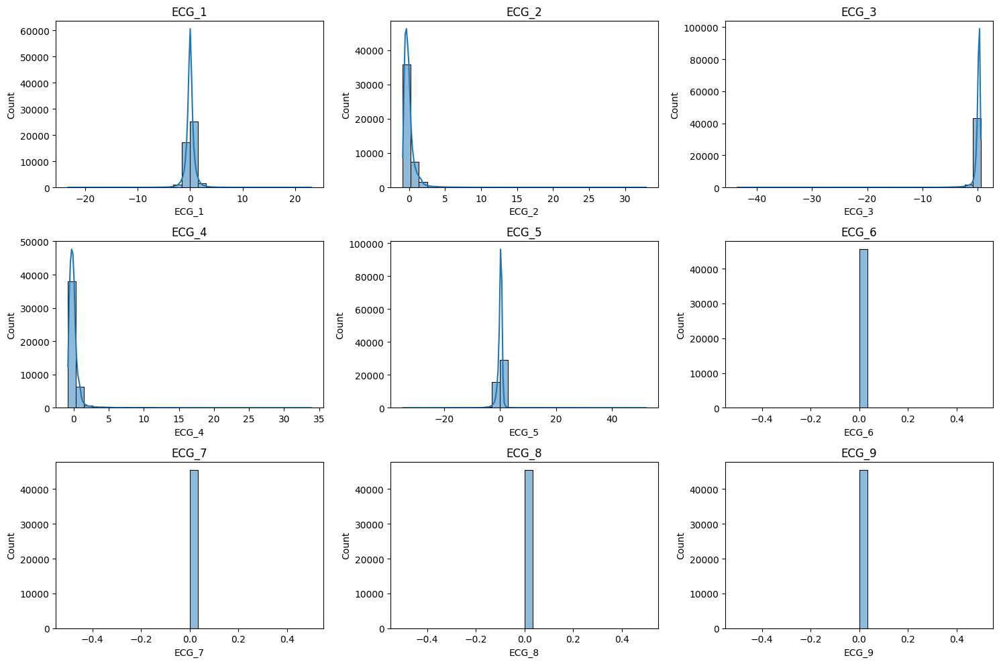


Visualizing Feature Correlation Matrix...


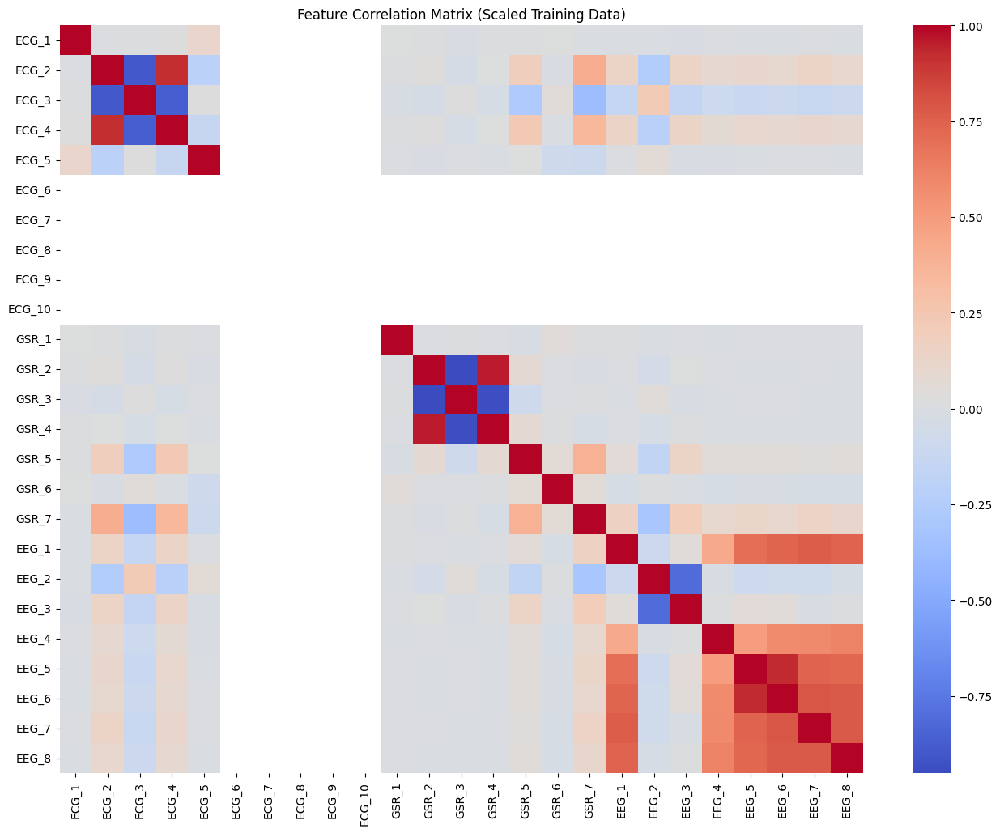


Highly Correlated Feature Pairs (Threshold > 0.9):
GSR_4  GSR_2    0.958947
GSR_3  GSR_2    0.952613
       GSR_4    0.940988
EEG_6  EEG_5    0.926888
ECG_2  ECG_4    0.918654
dtype: float64


In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_selection import VarianceThreshold

# --- Create Feature Names (Generic) ---
# You can replace these with more descriptive names if you have them
n_features = X_train_final.shape[1]
feature_names = []
if n_features >= 10: feature_names.extend([f'ECG_{i+1}' for i in range(10)])
if n_features >= 17: feature_names.extend([f'GSR_{i+1}' for i in range(7)])
if n_features >= 25: feature_names.extend([f'EEG_{i+1}' for i in range(8)])
# Add generic names if the total count doesn't match expected
if len(feature_names) < n_features:
     feature_names.extend([f'Other_{i+1}' for i in range(n_features - len(feature_names))])
elif len(feature_names) > n_features:
     feature_names = feature_names[:n_features]


# --- Convert to DataFrame for easier exploration ---
# Using the scaled training data for exploration
X_train_df = pd.DataFrame(X_train_final, columns=feature_names)
print("Feature DataFrame Head:")
print(X_train_df.head())
print("\nBasic Statistics of Features:")
print(X_train_df.describe())

# --- Check for Zero Variance Features (after scaling, less likely) ---
# Using a very small threshold because data is scaled
var_thresh = VarianceThreshold(threshold=0.01) # Threshold might need adjustment
try:
    var_thresh.fit(X_train_final)
    low_variance_cols = X_train_df.columns[~var_thresh.get_support()]
    if len(low_variance_cols) > 0:
        print(f"\nFeatures with low variance (threshold=0.01): {list(low_variance_cols)}")
    else:
        print("\nNo features found with variance below threshold=0.01.")
except ValueError as e:
    print(f"\nCould not perform variance threshold check: {e}") # e.g., if data is empty

# --- Visualize Feature Distributions (Example: First few features) ---
print("\nVisualizing Feature Distributions (Example: First 9 Features)...")
plt.figure(figsize=(15, 10))
# Select first 9 features or fewer if total features < 9
num_plot_features = min(9, X_train_df.shape[1])
for i in range(num_plot_features):
    plt.subplot(3, 3, i + 1)
    sns.histplot(X_train_df.iloc[:, i], kde=True, bins=30)
    plt.title(X_train_df.columns[i])
plt.tight_layout()
plt.show()

# --- Visualize Feature Correlations ---
print("\nVisualizing Feature Correlation Matrix...")
plt.figure(figsize=(16, 12))
correlation_matrix = X_train_df.corr()
sns.heatmap(correlation_matrix, cmap='coolwarm', annot=False) # Set annot=True for values, might be crowded
plt.title('Feature Correlation Matrix (Scaled Training Data)')
plt.show()

# --- Identify Highly Correlated Pairs (Example Threshold) ---
threshold = 0.90
# Find pairs with absolute correlation above the threshold
highly_correlated = correlation_matrix.abs().unstack().sort_values(ascending=False).drop_duplicates()
correlated_pairs = highly_correlated[(highly_correlated > threshold) & (highly_correlated < 1.0)] # Exclude self-correlation

if not correlated_pairs.empty:
    print(f"\nHighly Correlated Feature Pairs (Threshold > {threshold}):")
    print(correlated_pairs)
else:
    print(f"\nNo feature pairs found with absolute correlation > {threshold}.")

# --- Clean up ---
# del X_train_df, correlation_matrix, highly_correlated, correlated_pairs
# gc.collect()

## Class Balancing (Using Imbalanced-learn)

Original Training Set Class Distribution:
Counter({np.int64(3): 31043, np.int64(0): 7074, np.int64(1): 6738, np.int64(2): 699})


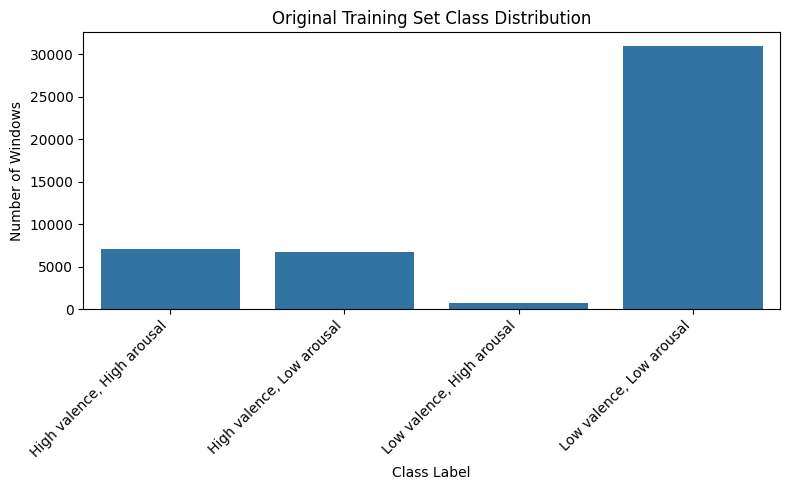


Applying SMOTE to the training data...

Training Set Class Distribution After SMOTE:
Counter({np.int64(3): 31043, np.int64(0): 31043, np.int64(1): 31043, np.int64(2): 31043})
Original training shape: (45554, 25), Resampled shape: (124172, 25)


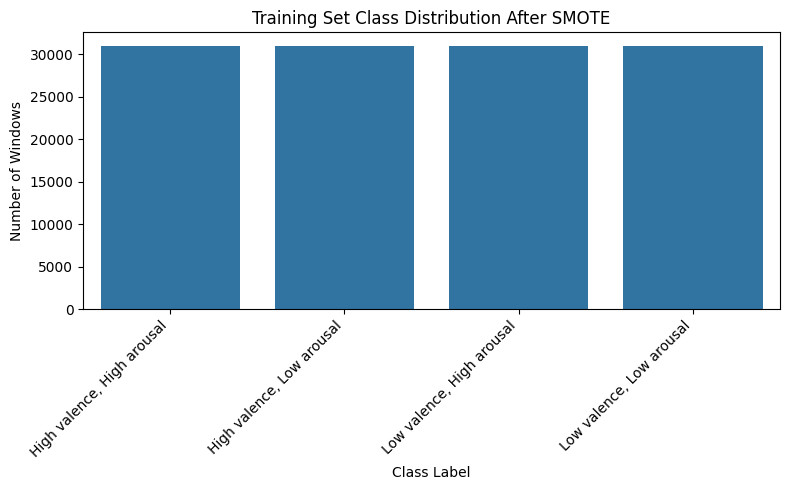

In [5]:
# Apply balancing techniques *only* to the training data (`X_train_final`, `y_train_final`). The test set (`X_test_final`) must remain untouched to provide an unbiased evaluation. We will demonstrate SMOTE here.

# %%
from collections import Counter
import matplotlib.pyplot as plt
import seaborn as sns
from imblearn.over_sampling import SMOTE, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler
import numpy as np

# --- Check original class distribution ---
print("Original Training Set Class Distribution:")
original_counts = Counter(y_train_final)
print(original_counts)

# Get class names if label_to_int_w exists
if 'label_to_int_w' in locals():
    int_to_label_w = {v: k for k, v in label_to_int_w.items()}
    class_names = [int_to_label_w[i] for i in sorted(original_counts.keys())]
else:
    class_names = [f'Class {i}' for i in sorted(original_counts.keys())]


plt.figure(figsize=(8, 5))
sns.countplot(x=y_train_final, order=sorted(original_counts.keys()))
plt.title('Original Training Set Class Distribution')
plt.xlabel('Class Label')
plt.ylabel('Number of Windows')
plt.xticks(ticks=sorted(original_counts.keys()), labels=class_names, rotation=45, ha='right')
plt.tight_layout()
plt.show()

# --- Apply SMOTE (Synthetic Minority Over-sampling Technique) ---
# Note: SMOTE should be applied AFTER splitting and typically AFTER scaling/imputation
print("\nApplying SMOTE to the training data...")
try:
    # Ensure X_train_final is C-contiguous, which SMOTE sometimes requires
    X_train_final_contiguous = np.ascontiguousarray(X_train_final)

    smote = SMOTE(random_state=42, k_neighbors=max(1, min(5, min(original_counts.values()) - 1))) # Adjust k_neighbors based on smallest class size
    X_train_smote, y_train_smote = smote.fit_resample(X_train_final_contiguous, y_train_final)

    print("\nTraining Set Class Distribution After SMOTE:")
    smote_counts = Counter(y_train_smote)
    print(smote_counts)
    print(f"Original training shape: {X_train_final.shape}, Resampled shape: {X_train_smote.shape}")


    plt.figure(figsize=(8, 5))
    sns.countplot(x=y_train_smote, order=sorted(smote_counts.keys()))
    plt.title('Training Set Class Distribution After SMOTE')
    plt.xlabel('Class Label')
    plt.ylabel('Number of Windows')
    plt.xticks(ticks=sorted(smote_counts.keys()), labels=class_names, rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

    # IMPORTANT: For subsequent model training, you would now use X_train_smote and y_train_smote
    # instead of X_train_final and y_train_final. The test set remains X_test_final, y_test_final.

except ValueError as e:
    print(f"\nError during SMOTE: {e}")
    print("Smallest class size might be too small for default k_neighbors. Check 'original_counts'.")
    print("Skipping SMOTE application.")
    # Assign original data if SMOTE failed, so subsequent cells don't break
    X_train_smote, y_train_smote = X_train_final, y_train_final


# --- (Optional) Example: Random Over-Sampling ---
# print("\nApplying RandomOverSampler...")
# ros = RandomOverSampler(random_state=42)
# X_train_ros, y_train_ros = ros.fit_resample(X_train_final_contiguous, y_train_final)
# print(f"Shape after ROS: {X_train_ros.shape}")
# print(Counter(y_train_ros))

# --- (Optional) Example: Random Under-Sampling ---
# print("\nApplying RandomUnderSampler...")
# rus = RandomUnderSampler(random_state=42)
# X_train_rus, y_train_rus = rus.fit_resample(X_train_final_contiguous, y_train_final)
# print(f"Shape after RUS: {X_train_rus.shape}")
# print(Counter(y_train_rus))
# print("Note: Undersampling might discard useful information.")

## Feature Fusion Strategies & Selection

Using SMOTE-balanced data for fitting feature selectors.

--- Applying SelectKBest (k=15) ---
Selected features (15): ['ECG_2', 'ECG_3', 'ECG_4', 'ECG_5', 'GSR_3', 'GSR_5', 'GSR_6', 'GSR_7', 'EEG_1', 'EEG_2', 'EEG_3', 'EEG_5', 'EEG_6', 'EEG_7', 'EEG_8']
Shape after SelectKBest: Train=(124172, 15), Test=(11389, 15)


C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\feature_selection\_univariate_selection.py:111: UserWarning: Features [5 6 7 8 9] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
C:\Users\ferri\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\feature_selection\_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


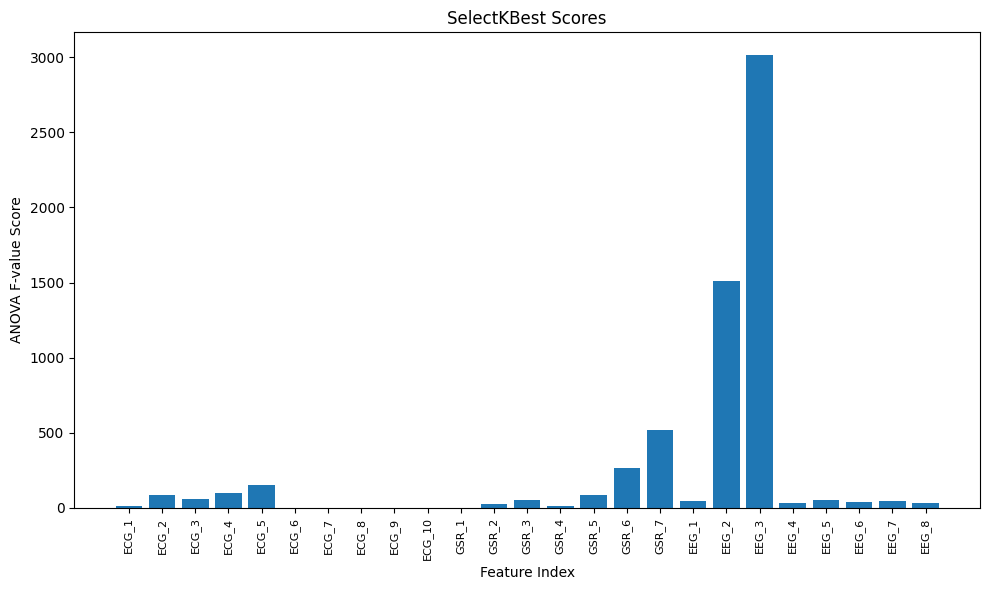


--- Using Embedded Method (Random Forest Feature Importance) ---
Training a new RandomForestClassifier for feature importances...

Feature Ranking (Random Forest Importance):
1. Feature GSR_7 (0.0777)
2. Feature ECG_4 (0.0685)
3. Feature EEG_3 (0.0636)
4. Feature EEG_1 (0.0596)
5. Feature ECG_2 (0.0587)
6. Feature ECG_3 (0.0566)
7. Feature GSR_6 (0.0557)
8. Feature EEG_2 (0.0531)
9. Feature EEG_7 (0.0527)
10. Feature GSR_5 (0.0519)
11. Feature EEG_4 (0.0498)
12. Feature ECG_5 (0.0459)
13. Feature EEG_8 (0.0448)
14. Feature GSR_3 (0.0405)
15. Feature EEG_6 (0.0391)
16. Feature GSR_4 (0.0387)
17. Feature ECG_1 (0.0384)
18. Feature EEG_5 (0.0374)
19. Feature GSR_1 (0.0341)
20. Feature GSR_2 (0.0333)
21. Feature ECG_10 (0.0000)
22. Feature ECG_9 (0.0000)
23. Feature ECG_6 (0.0000)
24. Feature ECG_8 (0.0000)
25. Feature ECG_7 (0.0000)


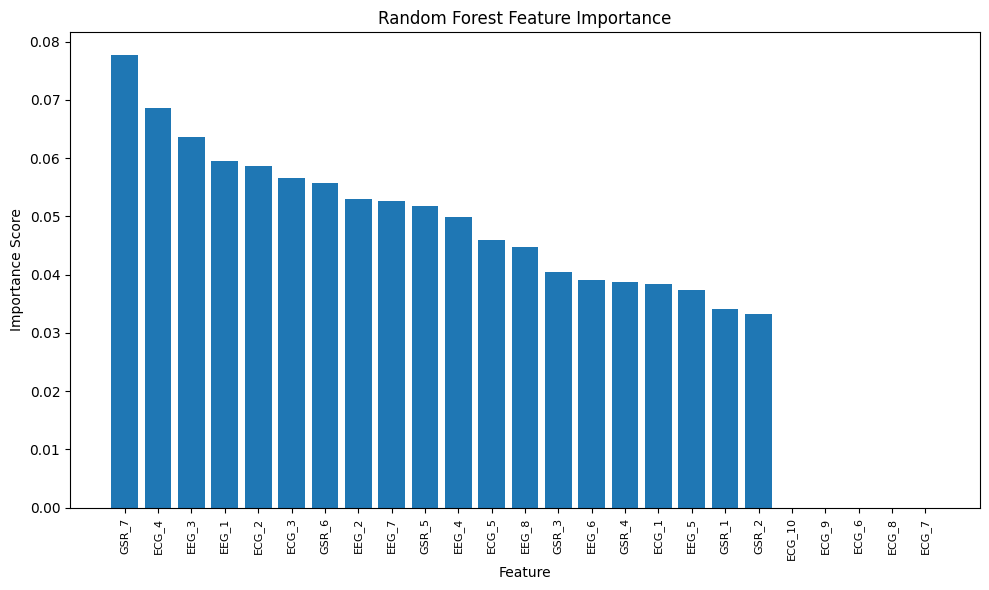


Applying SelectFromModel based on RF importance...
Selected features (13 using median threshold): ['ECG_2', 'ECG_3', 'ECG_4', 'ECG_5', 'GSR_5', 'GSR_6', 'GSR_7', 'EEG_1', 'EEG_2', 'EEG_3', 'EEG_4', 'EEG_7', 'EEG_8']
Shape after SelectFromModel: Train=(124172, 13), Test=(11389, 13)

--- Applying RFE (Recursive Feature Elimination) ---
Targeting 10 features.
Fitting RFE selector (this may take some time)...
Selected features (10): ['GSR_2', 'GSR_3', 'GSR_4', 'GSR_7', 'EEG_1', 'EEG_2', 'EEG_3', 'EEG_5', 'EEG_6', 'EEG_8']
RFE Ranking: [ 9  3  2  7  4 12 16 15 14 13 11  1  1  1 10  8  1  1  1  1  5  1  1  6
  1]
Shape after RFE: Train=(124172, 10), Test=(11389, 10)

--- Feature Selection Complete ---
You can now train models using the selected feature subsets:
 - SelectKBest: X_train_kbest ((124172, 15)), X_test_kbest ((11389, 15))
 - SelectFromModel (RF): X_train_sfm ((124172, 13)), X_test_sfm ((11389, 13))
 - RFE: X_train_rfe ((124172, 10)), X_test_rfe ((11389, 10))
Remember to use the c

In [6]:
# The current approach uses early fusion (concatenating features from all modalities before training). This cell explores selecting the *most relevant* features from this fused set. We can use filter methods, wrapper methods, or embedded methods.
#
# **Note:** Feature selection should ideally be performed *after* balancing if balancing is used, using the balanced training data (`X_train_smote`, `y_train_smote`) for fitting the selector. The selector is then used to transform both the (balanced) training set and the *original* test set.

# %%
from sklearn.feature_selection import SelectKBest, f_classif, RFE, SelectFromModel
from sklearn.linear_model import LogisticRegression # Example estimator for RFE/SelectFromModel
from sklearn.ensemble import RandomForestClassifier # Example estimator for embedded importance
import matplotlib.pyplot as plt
import numpy as np

# --- Decide which training data to use for fitting selectors ---
# Use SMOTE-balanced data if it was successfully generated
if 'X_train_smote' in locals() and X_train_smote.shape[0] > X_train_final.shape[0]:
     print("Using SMOTE-balanced data for fitting feature selectors.")
     X_train_for_select = X_train_smote
     y_train_for_select = y_train_smote
else:
     print("Using original (imputed, scaled) training data for fitting feature selectors.")
     X_train_for_select = X_train_final
     y_train_for_select = y_train_final

# Ensure data is contiguous if needed by selectors
X_train_for_select = np.ascontiguousarray(X_train_for_select)
X_test_final_contiguous = np.ascontiguousarray(X_test_final) # Ensure test set is also contiguous for transform

# --- Strategy 1: Filter Method (SelectKBest using ANOVA F-value) ---
k_best_features = 15 # Example: select top 15 features (adjust based on exploration/needs)
print(f"\n--- Applying SelectKBest (k={k_best_features}) ---")

# Check if k is valid
if k_best_features >= X_train_for_select.shape[1]:
    print(f"Warning: k={k_best_features} is >= number of features ({X_train_for_select.shape[1]}). Skipping SelectKBest.")
    X_train_kbest = X_train_for_select
    X_test_kbest = X_test_final_contiguous # Use original test set
    selected_kbest_indices = np.arange(X_train_for_select.shape[1]) # All indices selected
else:
    try:
        selector_kbest = SelectKBest(score_func=f_classif, k=k_best_features)
        selector_kbest.fit(X_train_for_select, y_train_for_select)

        # Get indices of selected features
        selected_kbest_indices = selector_kbest.get_support(indices=True)
        selected_feature_names = [feature_names[i] for i in selected_kbest_indices] # Use feature_names from exploration cell

        print(f"Selected features ({k_best_features}): {selected_feature_names}")

        # Transform both training and test sets
        X_train_kbest = selector_kbest.transform(X_train_for_select)
        X_test_kbest = selector_kbest.transform(X_test_final_contiguous) # Apply same transform to original test set

        print(f"Shape after SelectKBest: Train={X_train_kbest.shape}, Test={X_test_kbest.shape}")

        # Visualize scores (optional)
        plt.figure(figsize=(10, 6))
        plt.bar(range(len(selector_kbest.scores_)), selector_kbest.scores_)
        plt.xlabel('Feature Index')
        plt.ylabel('ANOVA F-value Score')
        plt.title('SelectKBest Scores')
        plt.xticks(ticks=range(len(feature_names)), labels=feature_names, rotation=90, fontsize=8)
        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"Error during SelectKBest: {e}. Skipping.")
        X_train_kbest = X_train_for_select
        X_test_kbest = X_test_final_contiguous
        selected_kbest_indices = np.arange(X_train_for_select.shape[1])


# --- Strategy 2: Embedded Method (Feature Importance from RandomForest) ---
# Use a trained model (e.g., the best RF from previous tuning, or train a new one)
print("\n--- Using Embedded Method (Random Forest Feature Importance) ---")
# Option 1: Use best model if it exists and is RF/ET
best_model_from_tuning = None
if 'best_overall_model' in locals() and isinstance(best_overall_model, (RandomForestClassifier, ExtraTreesClassifier)):
     print("Using best tuned RF/ET model for feature importances.")
     best_model_from_tuning = best_overall_model # Assumes it was trained on X_train_final/smote
     # Ensure the model is fitted, otherwise fit it here
     # try:
     #      check_is_fitted(best_model_from_tuning)
     # except NotFittedError:
     #      print("Refitting best model...")
     #      best_model_from_tuning.fit(X_train_for_select, y_train_for_select)

# Option 2: Train a simple RF specifically for feature importance
if best_model_from_tuning is None:
     print("Training a new RandomForestClassifier for feature importances...")
     rf_for_importance = RandomForestClassifier(n_estimators=100, random_state=42, n_jobs=-1, class_weight='balanced')
     try:
        rf_for_importance.fit(X_train_for_select, y_train_for_select)
        importances = rf_for_importance.feature_importances_
        model_to_use_importance = rf_for_importance # Used later in SelectFromModel
     except Exception as e:
        print(f"Error training RF for importance: {e}")
        importances = None
        model_to_use_importance = None
else:
     importances = best_model_from_tuning.feature_importances_
     model_to_use_importance = best_model_from_tuning

if importances is not None:
    indices = np.argsort(importances)[::-1]
    print("\nFeature Ranking (Random Forest Importance):")
    for f in range(X_train_for_select.shape[1]):
        print(f"{f + 1}. Feature {feature_names[indices[f]]} ({importances[indices[f]]:.4f})")

    # Visualize importances
    plt.figure(figsize=(10, 6))
    plt.bar(range(X_train_for_select.shape[1]), importances[indices], align='center')
    plt.xticks(range(X_train_for_select.shape[1]), [feature_names[i] for i in indices], rotation=90, fontsize=8)
    plt.xlabel('Feature')
    plt.ylabel('Importance Score')
    plt.title('Random Forest Feature Importance')
    plt.tight_layout()
    plt.show()

    # --- Use SelectFromModel with the trained RF ---
    print("\nApplying SelectFromModel based on RF importance...")
    # Threshold can be median importance, or a fraction like '1.25*median'
    # Or specify max_features
    selector_sfm = SelectFromModel(estimator=model_to_use_importance, threshold='median', prefit=True) # Use prefit=True as model is already trained
    try:
        X_train_sfm = selector_sfm.transform(X_train_for_select)
        X_test_sfm = selector_sfm.transform(X_test_final_contiguous)
        selected_sfm_indices = selector_sfm.get_support(indices=True)
        selected_sfm_names = [feature_names[i] for i in selected_sfm_indices]
        print(f"Selected features ({len(selected_sfm_names)} using median threshold): {selected_sfm_names}")
        print(f"Shape after SelectFromModel: Train={X_train_sfm.shape}, Test={X_test_sfm.shape}")
    except Exception as e:
        print(f"Error during SelectFromModel: {e}. Skipping.")
        X_train_sfm = X_train_for_select
        X_test_sfm = X_test_final_contiguous
        selected_sfm_indices = np.arange(X_train_for_select.shape[1])

else:
    print("Could not calculate feature importances. Skipping SelectFromModel.")
    X_train_sfm = X_train_for_select
    X_test_sfm = X_test_final_contiguous
    selected_sfm_indices = np.arange(X_train_for_select.shape[1])


# --- Strategy 3: Wrapper Method (Recursive Feature Elimination - RFE) ---
# RFE is computationally more expensive.
print(f"\n--- Applying RFE (Recursive Feature Elimination) ---")
n_features_to_select_rfe = 10 # Example: Select top 10 features
print(f"Targeting {n_features_to_select_rfe} features.")

# Check if n_features_to_select is valid
if n_features_to_select_rfe >= X_train_for_select.shape[1]:
    print(f"Warning: n_features_to_select={n_features_to_select_rfe} is >= number of features. Skipping RFE.")
    X_train_rfe = X_train_for_select
    X_test_rfe = X_test_final_contiguous
    selected_rfe_indices = np.arange(X_train_for_select.shape[1])
else:
    # Using a simple Logistic Regression as the estimator for RFE
    # You could use other models like SVC(kernel='linear') or DecisionTreeClassifier
    estimator_rfe = LogisticRegression(max_iter=1000, solver='liblinear', class_weight='balanced')
    try:
        selector_rfe = RFE(estimator=estimator_rfe, n_features_to_select=n_features_to_select_rfe, step=1) # step=1 removes one feature per iteration
        print("Fitting RFE selector (this may take some time)...")
        selector_rfe.fit(X_train_for_select, y_train_for_select)

        selected_rfe_indices = selector_rfe.get_support(indices=True)
        selected_rfe_names = [feature_names[i] for i in selected_rfe_indices]
        print(f"Selected features ({n_features_to_select_rfe}): {selected_rfe_names}")
        print(f"RFE Ranking: {selector_rfe.ranking_}") # Lower rank is better (1 = selected)

        # Transform training and test sets
        X_train_rfe = selector_rfe.transform(X_train_for_select)
        X_test_rfe = selector_rfe.transform(X_test_final_contiguous)
        print(f"Shape after RFE: Train={X_train_rfe.shape}, Test={X_test_rfe.shape}")

    except Exception as e:
        print(f"Error during RFE: {e}. Skipping.")
        X_train_rfe = X_train_for_select
        X_test_rfe = X_test_final_contiguous
        selected_rfe_indices = np.arange(X_train_for_select.shape[1])

# --- Conclusion ---
print("\n--- Feature Selection Complete ---")
print("You can now train models using the selected feature subsets:")
print(f" - SelectKBest: X_train_kbest ({X_train_kbest.shape}), X_test_kbest ({X_test_kbest.shape})")
print(f" - SelectFromModel (RF): X_train_sfm ({X_train_sfm.shape}), X_test_sfm ({X_test_sfm.shape})")
print(f" - RFE: X_train_rfe ({X_train_rfe.shape}), X_test_rfe ({X_test_rfe.shape})")
print("Remember to use the corresponding y_train (e.g., y_train_smote or y_train_final) and y_test_final for training and evaluation.")

# --- Clean up (optional) ---
# del X_train_kbest, X_test_kbest, X_train_sfm, X_test_sfm, X_train_rfe, X_test_rfe
# del selector_kbest, selector_sfm, selector_rfe, rf_for_importance
# gc.collect()

## Train Standard Machine Learning Models on Selected Features

--- Preparing data using feature set: smote_kbest ---
Using y_train_smote for training.

Selected Training Data Shape: (124172, 15)
Selected Training Labels Shape: (124172,)
Selected Test Data Shape: (11389, 15)
Actual Test Labels Shape: (11389,)
Training Class Distribution: Counter({np.int64(3): 31043, np.int64(0): 31043, np.int64(1): 31043, np.int64(2): 31043})
Test Class Distribution: Counter({np.int64(3): 7761, np.int64(0): 1769, np.int64(1): 1685, np.int64(2): 174})

Using class names for reporting: [np.str_('High valence, High arousal'), np.str_('High valence, Low arousal'), np.str_('Low valence, High arousal'), np.str_('Low valence, Low arousal')]

--- Training Logistic Regression ---
Training Time: 1.40s
Prediction Time: 0.00s
Accuracy: 0.2174
Weighted F1-Score: 0.2186
Classification Report:
                            precision    recall  f1-score   support

High valence, High arousal       0.20      0.48      0.28      1769
 High valence, Low arousal       0.21      0.39     

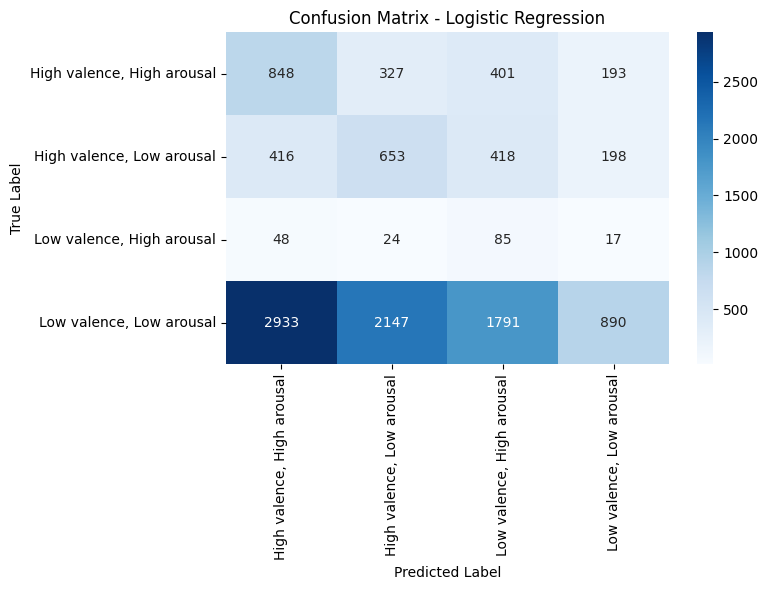


--- Training K-Nearest Neighbors ---
Training Time: 0.25s
Prediction Time: 5.92s
Accuracy: 0.4459
Weighted F1-Score: 0.4847
Classification Report:
                            precision    recall  f1-score   support

High valence, High arousal       0.29      0.54      0.38      1769
 High valence, Low arousal       0.26      0.46      0.33      1685
 Low valence, High arousal       0.07      0.39      0.12       174
  Low valence, Low arousal       0.79      0.42      0.55      7761

                  accuracy                           0.45     11389
                 macro avg       0.35      0.45      0.34     11389
              weighted avg       0.62      0.45      0.48     11389

Confusion Matrix:


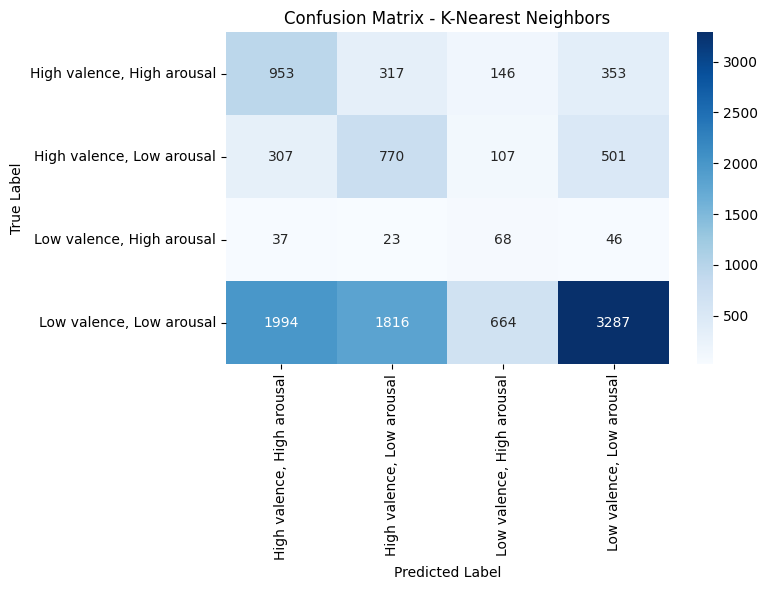


--- Training Random Forest ---
Training Time: 4.31s
Prediction Time: 0.06s
Accuracy: 0.6783
Weighted F1-Score: 0.6756
Classification Report:
                            precision    recall  f1-score   support

High valence, High arousal       0.47      0.42      0.44      1769
 High valence, Low arousal       0.44      0.42      0.43      1685
 Low valence, High arousal       0.26      0.34      0.30       174
  Low valence, Low arousal       0.78      0.80      0.79      7761

                  accuracy                           0.68     11389
                 macro avg       0.49      0.50      0.49     11389
              weighted avg       0.67      0.68      0.68     11389

Confusion Matrix:


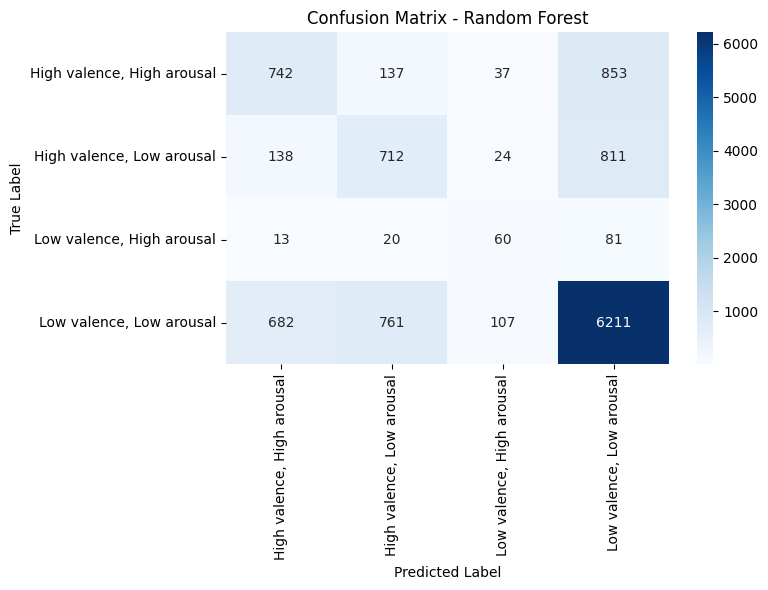


--- Overall Model Performance Summary ---
                 Model  Accuracy  Weighted F1  Train Time (s)
2        Random Forest  0.678286     0.675629        4.309800
1  K-Nearest Neighbors  0.445869     0.484658        0.245084
0  Logistic Regression  0.217403     0.218561        1.395907


In [7]:
import time
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
from sklearn.utils.multiclass import unique_labels
import numpy as np
import gc # Optional for memory management

# --- Configuration ---
# Choose which feature set to use for training and testing.
# Options created in the previous cell:
# 'kbest': Uses X_train_kbest, X_test_kbest
# 'sfm': Uses X_train_sfm, X_test_sfm
# 'rfe': Uses X_train_rfe, X_test_rfe
# 'final': Uses X_train_final, X_test_final (original scaled/imputed, no selection)
# 'smote_final': Uses X_train_smote, X_test_final (SMOTE balanced, no selection) - Use if SMOTE was applied but no feature selection afterward.
# 'smote_kbest': Uses X_train_kbest, X_test_kbest (where kbest was fitted on SMOTE data)
# 'smote_sfm': Uses X_train_sfm, X_test_sfm (where sfm was fitted on SMOTE data)
# 'smote_rfe': Uses X_train_rfe, X_test_rfe (where rfe was fitted on SMOTE data)

FEATURE_SET_TO_USE = 'smote_kbest' # <<< CHANGE THIS AS NEEDED

# --- Prepare Data Based on Selection ---
print(f"--- Preparing data using feature set: {FEATURE_SET_TO_USE} ---")

try:
    # Select X data
    if FEATURE_SET_TO_USE == 'kbest':
        if 'X_train_kbest' not in locals() or 'X_test_kbest' not in locals():
             raise NameError("kbest feature sets (X_train_kbest, X_test_kbest) not found.")
        X_train_selected = X_train_kbest
        X_test_selected = X_test_kbest
        # Determine correct y_train (was kbest based on original or smote?)
        if 'X_train_smote' in locals() and X_train_kbest.shape[0] == X_train_smote.shape[0]: # Check if kbest was likely fitted on SMOTE
             y_train_selected = y_train_smote
             print("Using y_train_smote for training.")
        else:
             y_train_selected = y_train_final
             print("Using y_train_final for training.")

    elif FEATURE_SET_TO_USE == 'sfm':
        if 'X_train_sfm' not in locals() or 'X_test_sfm' not in locals():
             raise NameError("SelectFromModel feature sets (X_train_sfm, X_test_sfm) not found.")
        X_train_selected = X_train_sfm
        X_test_selected = X_test_sfm
        # Determine correct y_train
        if 'X_train_smote' in locals() and X_train_sfm.shape[0] == X_train_smote.shape[0]:
             y_train_selected = y_train_smote
             print("Using y_train_smote for training.")
        else:
             y_train_selected = y_train_final
             print("Using y_train_final for training.")

    elif FEATURE_SET_TO_USE == 'rfe':
        if 'X_train_rfe' not in locals() or 'X_test_rfe' not in locals():
             raise NameError("RFE feature sets (X_train_rfe, X_test_rfe) not found.")
        X_train_selected = X_train_rfe
        X_test_selected = X_test_rfe
        # Determine correct y_train
        if 'X_train_smote' in locals() and X_train_rfe.shape[0] == X_train_smote.shape[0]:
             y_train_selected = y_train_smote
             print("Using y_train_smote for training.")
        else:
             y_train_selected = y_train_final
             print("Using y_train_final for training.")

    elif FEATURE_SET_TO_USE == 'final':
         if 'X_train_final' not in locals() or 'X_test_final' not in locals():
             raise NameError("Original processed data (X_train_final, X_test_final) not found.")
         X_train_selected = X_train_final
         X_test_selected = X_test_final
         y_train_selected = y_train_final # Use original y_train
         print("Using y_train_final for training.")

    elif FEATURE_SET_TO_USE == 'smote_final':
        if 'X_train_smote' not in locals() or 'y_train_smote' not in locals() or 'X_test_final' not in locals():
             raise NameError("SMOTE data (X_train_smote, y_train_smote) or test data (X_test_final) not found.")
        X_train_selected = X_train_smote
        # IMPORTANT: Test set remains the original one, but should be contiguous if not already
        X_test_selected = np.ascontiguousarray(X_test_final)
        y_train_selected = y_train_smote
        print("Using y_train_smote for training.")

    # ---- Combinations of SMOTE + Selection ----
    elif FEATURE_SET_TO_USE == 'smote_kbest':
        if 'X_train_kbest' not in locals() or 'X_test_kbest' not in locals() or 'y_train_smote' not in locals():
             raise NameError("SMOTE-based kbest sets (X_train_kbest, X_test_kbest) or y_train_smote not found.")
        # Assume X_train_kbest/X_test_kbest were created based on SMOTE data in the previous cell
        X_train_selected = X_train_kbest
        X_test_selected = X_test_kbest
        y_train_selected = y_train_smote
        print("Using y_train_smote for training.")

    elif FEATURE_SET_TO_USE == 'smote_sfm':
        if 'X_train_sfm' not in locals() or 'X_test_sfm' not in locals() or 'y_train_smote' not in locals():
             raise NameError("SMOTE-based sfm sets (X_train_sfm, X_test_sfm) or y_train_smote not found.")
        X_train_selected = X_train_sfm
        X_test_selected = X_test_sfm
        y_train_selected = y_train_smote
        print("Using y_train_smote for training.")

    elif FEATURE_SET_TO_USE == 'smote_rfe':
         if 'X_train_rfe' not in locals() or 'X_test_rfe' not in locals() or 'y_train_smote' not in locals():
             raise NameError("SMOTE-based rfe sets (X_train_rfe, X_test_rfe) or y_train_smote not found.")
         X_train_selected = X_train_rfe
         X_test_selected = X_test_rfe
         y_train_selected = y_train_smote
         print("Using y_train_smote for training.")

    else:
        raise ValueError(f"Invalid FEATURE_SET_TO_USE: {FEATURE_SET_TO_USE}")

    # Ensure the final selected test labels exist
    if 'y_test_final' not in locals():
        raise NameError("Original test labels y_test_final not found.")
    y_test_actual = y_test_final

    # Ensure data is contiguous (might be needed by some models)
    X_train_selected = np.ascontiguousarray(X_train_selected)
    X_test_selected = np.ascontiguousarray(X_test_selected)
    y_train_selected = np.ascontiguousarray(y_train_selected)
    y_test_actual = np.ascontiguousarray(y_test_actual)


    print(f"\nSelected Training Data Shape: {X_train_selected.shape}")
    print(f"Selected Training Labels Shape: {y_train_selected.shape}")
    print(f"Selected Test Data Shape: {X_test_selected.shape}")
    print(f"Actual Test Labels Shape: {y_test_actual.shape}")
    print(f"Training Class Distribution: {Counter(y_train_selected)}")
    print(f"Test Class Distribution: {Counter(y_test_actual)}")


except (NameError, ValueError) as e:
    print(f"Error preparing data: {e}")
    print("Cannot proceed with model training. Please ensure the prerequisite cells ran successfully and the selected feature set exists.")
    # Optionally raise the error again if you want execution to stop:
    # raise e
else:
    # --- Define Models ---
    # Using standard parameters. For best results, hyperparameters should be tuned (e.g., using GridSearchCV).
    models = {
        "Logistic Regression": LogisticRegression(max_iter=1000, random_state=42, solver='liblinear', class_weight='balanced'),
        "K-Nearest Neighbors": KNeighborsClassifier(n_neighbors=5), # k=5 is common, might need tuning
        "Random Forest": RandomForestClassifier(n_estimators=100, random_state=42, n_jobs=-1, class_weight='balanced')
    }

    # --- Train and Evaluate Models ---
    results = {}

    # Get class names for confusion matrix labels if available
    if 'label_to_int_w' in locals():
         int_to_label_w = {v: k for k, v in label_to_int_w.items()}
         # Ensure class names are sorted according to their integer index
         class_names = [int_to_label_w[i] for i in sorted(unique_labels(y_train_selected, y_test_actual))]
    else:
         class_names = [f'Class {i}' for i in sorted(unique_labels(y_train_selected, y_test_actual))]
    print(f"\nUsing class names for reporting: {class_names}")

    for name, model in models.items():
        print(f"\n--- Training {name} ---")
        start_time = time.time()

        # Train the model
        model.fit(X_train_selected, y_train_selected)
        train_time = time.time() - start_time

        # Predict on the test set
        start_time = time.time()
        y_pred = model.predict(X_test_selected)
        predict_time = time.time() - start_time

        # Evaluate
        accuracy = accuracy_score(y_test_actual, y_pred)
        weighted_f1 = f1_score(y_test_actual, y_pred, average='weighted')
        report = classification_report(y_test_actual, y_pred, target_names=class_names, zero_division=0)
        cm = confusion_matrix(y_test_actual, y_pred, labels=sorted(unique_labels(y_train_selected, y_test_actual))) # Ensure labels are sorted for consistency

        results[name] = {
            'Accuracy': accuracy,
            'Weighted F1': weighted_f1,
            'Classification Report': report,
            'Confusion Matrix': cm,
            'Train Time (s)': train_time,
            'Predict Time (s)': predict_time
        }

        print(f"Training Time: {train_time:.2f}s")
        print(f"Prediction Time: {predict_time:.2f}s")
        print(f"Accuracy: {accuracy:.4f}")
        print(f"Weighted F1-Score: {weighted_f1:.4f}")
        print("Classification Report:")
        print(report)
        print("Confusion Matrix:")
        # Plot confusion matrix
        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
        plt.title(f'Confusion Matrix - {name}')
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.tight_layout()
        plt.show()

    # --- Summarize Results ---
    print("\n--- Overall Model Performance Summary ---")
    results_summary = pd.DataFrame({
        'Model': list(results.keys()),
        'Accuracy': [res['Accuracy'] for res in results.values()],
        'Weighted F1': [res['Weighted F1'] for res in results.values()],
        'Train Time (s)': [res['Train Time (s)'] for res in results.values()]
    }).sort_values(by='Weighted F1', ascending=False) # Sort by F1-score

    print(results_summary)

    # Clean up large data if needed
    # del X_train_selected, X_test_selected, y_train_selected, y_test_actual
    # del models, results, results_summary
    # gc.collect()